In [1]:
import pandas as pd
import numpy as np
import cv2
import easyocr
import matplotlib.pyplot as plt
#from google.colab.patches import cv2_imshow
from pdf2image import convert_from_path
import re
from fuzzywuzzy import fuzz,process
from PIL import Image

C:\Users\hardi\anaconda3\lib\site-packages\fuzzywuzzy\fuzz.py:11: UserWarning: Using slow pure-python SequenceMatcher. Install python-Levenshtein to remove this warning
  warnings.warn('Using slow pure-python SequenceMatcher. Install python-Levenshtein to remove this warning')


In [2]:
reader = easyocr.Reader(['en'])

CUDA not available - defaulting to CPU. Note: This module is much faster with a GPU.
C:\Users\hardi\anaconda3\lib\site-packages\torchvision\models\_utils.py:252: UserWarning: Accessing the model URLs via the internal dictionary of the module is deprecated since 0.13 and will be removed in 0.15. Please access them via the appropriate Weights Enum instead.
  warnings.warn(
C:\Users\hardi\anaconda3\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
C:\Users\hardi\anaconda3\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


In [3]:
reader

In [4]:
def extract_text(image):
    output=reader.readtext(image)
    output1 = reader.readtext(image, allowlist ='0123456789')
    
    for i in range(len(output)):
        result=output[i][-2]
        
    for i in range(len(output1)):
        result1=output1[i][-2]
        
        
    df1=pd.DataFrame(output)
    Extract_text=pd.DataFrame(df1[1])
    Extract_text.columns=['Text']
    
    df2=pd.DataFrame(output1)
    Extract_text1=pd.DataFrame(df2[1])
    Extract_text1.columns=['Number']
    Name=[]
    for element in Extract_text['Text']:
        if re.findall('UNIQUE IDENTIFICATION AUTHORITY OF INDIA',element):
            rowNAME=Extract_text[Extract_text['Text']=='UNIQUE IDENTIFICATION AUTHORITY OF INDIA'].index
            rowNAME=rowNAME[0]
            rNAME=rowNAME+2
            NAME1=Extract_text.iloc[rNAME,0]
            Name.append(NAME1)
            print('Name:', Name)
        elif re.findall('Government of India',element):
            rowNAME=Extract_text[Extract_text['Text']=='Government of India'].index
            rowNAME=rowNAME[0]
            rNAME=rowNAME+2
            remaining_name=Extract_text['Text'].iloc[rowNAME+3]
            NAME1=Extract_text.iloc[rNAME,0]
            if any(char.isdigit() for char in NAME1):
                pass
            else:
                Name.append(NAME1)
            if any(char.isdigit() for char in remaining_name):
                pass
            elif any(char.isdigit() and char.isalpha() for char in remaining_name):
                pass
            else:
                rFullname=rowNAME+3
                NAME2=Extract_text.iloc[rFullname,0]
                Name.append(NAME2)
            print('Name:', Name)
        elif re.findall('GOVERNMENT OF INDIA',element):
            rowNAME=Extract_text[Extract_text['Text']=='GOVERNMENT OF INDIA'].index
            rowNAME=rowNAME[0]
            rNAME=rowNAME+2
            NAME1=Extract_text.iloc[rNAME,0]
            Name.append(NAME1)
            print('Name:', Name)
        elif re.findall('GCVERNVEHOFINDA',element):
            rowNAME=Extract_text[Extract_text['Text']=='GCVERNVEHOFINDA'].index
            rowNAME=rowNAME[0]
            rNAME=rowNAME+10
            NAME1=Extract_text.iloc[rNAME,0]
            Name.append(NAME1)
            print('Name:', Name)
    # for gender
    Gender = []
    for element in Extract_text['Text']:
        if re.findall('(Female|Male|emale|male|ale|FEMALE|MALE|EMALE)$', element):
            Gender.append(re.findall('(Female|Male|emale|male|ale|FEMALE|MALE|EMALE)$', element))
    print("Gender:", Gender[0])
    # for date of birth
    DOB = []
    YOB = []
    for element in Extract_text['Text']:
        if re.findall('Year of Birth',element):
            rowYOB=Extract_text[Extract_text['Text']=='Year of Birth'].index
            rYOB=rowYOB[0]
            rYOB=rYOB+1
            YOB1=Extract_text.iloc[rYOB,0]
            YOB.append(YOB1)
    
            print('Year of Birth:',YOB)
        elif re.findall('of Birth',element):
            rowYOB=Extract_text[Extract_text['Text']=='of Birth'].index
            rYOB=rowYOB[0]
            rYOB=rYOB+1
            YOB1=Extract_text.iloc[rYOB,0]
            YOB.append(YOB1)
            print('Year of Birth:',YOB)
        elif re.findall('[0-9]{2}/[0-9]{2}/[0-9]{4}', element):
            DOB.append(re.findall('[0-9]{2}/[0-9]{2}/[0-9]{4}', element))
            print("Date of Birth :", DOB[0])
        elif re.findall('[0-9]{4}-[0-9]{2}-[0-9]{2}', element):
            DOB.append(re.findall('[0-9]{4}-[0-9]{2}-[0-9]{2}', element))
            print("Date of Birth :", DOB[0])
        elif re.findall('Year of Birth: [0-9]{4}|of Birth [0-9]{4}|of Birth: [0-9]{4}', element):
            year=re.findall('Year of Birth: [0-9]{4}|of Birth [0-9]{4}|of Birth: [0-9]{4}', element)
            YOB.append(year)    
            print(YOB)   
        elif re.findall('of Birth [0-9]{4}|of Birth: [0-9]{4}', element):
            year1=re.findall('of Birth [0-9]{4}|of Birth: [0-9]{4}', element)
            YOB.append(year1)
        else:
            #print('x')
            pass
  #for adhar number
    Adhar_number=[]
    for element in Extract_text['Text'].tail(7):
        if re.findall('\d{4} \d{4} \d{4}'or'\d{12}', element):
            Adhar_number.append(re.findall('\d{4} \d{4} \d{4}'or'\d{12}', element))
        else:
            if(element.isdigit()):
                if len(element)==4:
                    if (len(YOB)!=0):
                        if YOB[0] in element:
                            pass
                        #elif DOB[0] in element:
                            #pass
                        else:
                            Adhar_number.append(element)
                    else:        
                        Adhar_number.append(element)
                
    #Adhar_number = Adhar_number[0]
    print('adhar number :',Adhar_number)

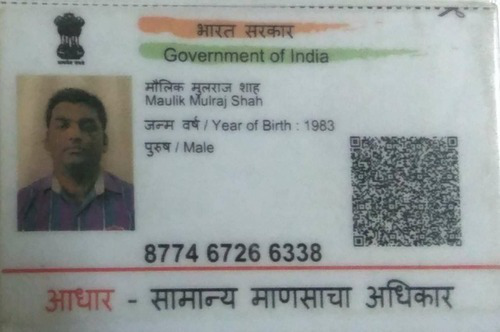

In [5]:
import PIL
from PIL import ImageDraw
img1 = PIL.Image.open('C://Users//hardi//Desktop//Scan and capture//new drive//adhar card//adhar 1.jpeg')
img1

In [6]:
extract_text(img1)

Name: ['Maulik', 'Moiraj Shar']
Gender: ['Male']
Year of Birth: ['1983']
adhar number : [['8774 6726 6338']]


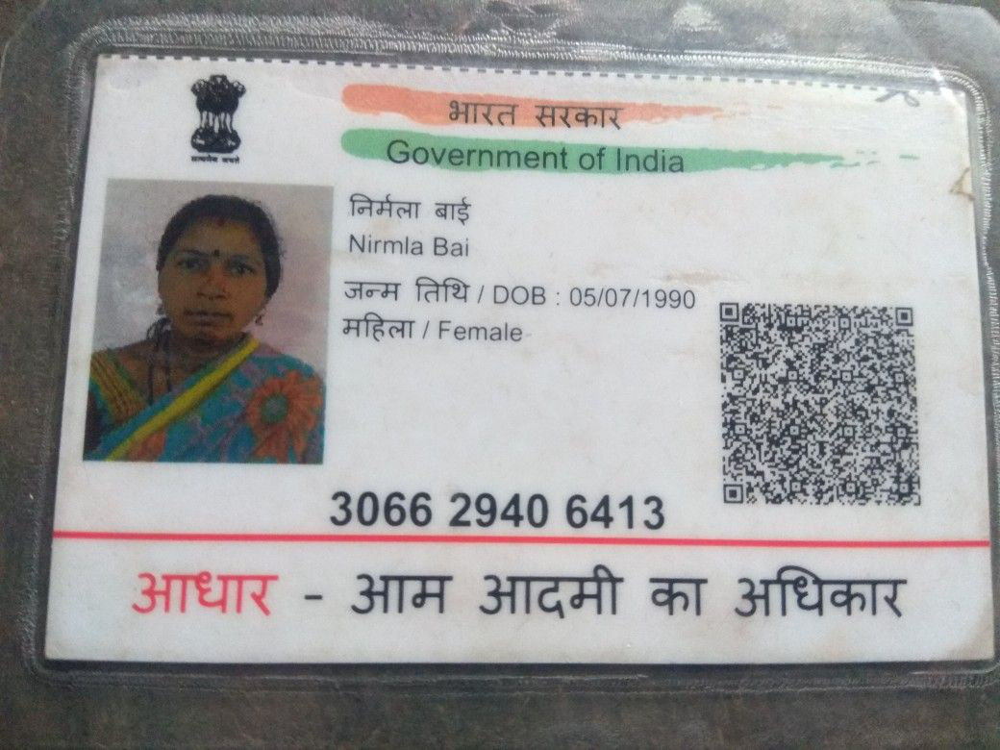

In [7]:
import PIL
from PIL import ImageDraw
img2 = PIL.Image.open('C://Users//hardi//Desktop//Scan and capture//new drive//adhar card//adhar 2.jpeg')
img2

In [8]:
extract_text(img2)

Name: ['Nirmla Bai']
Gender: ['Female']
Date of Birth : ['05/07/1990']
adhar number : [['3066 2940 6413']]


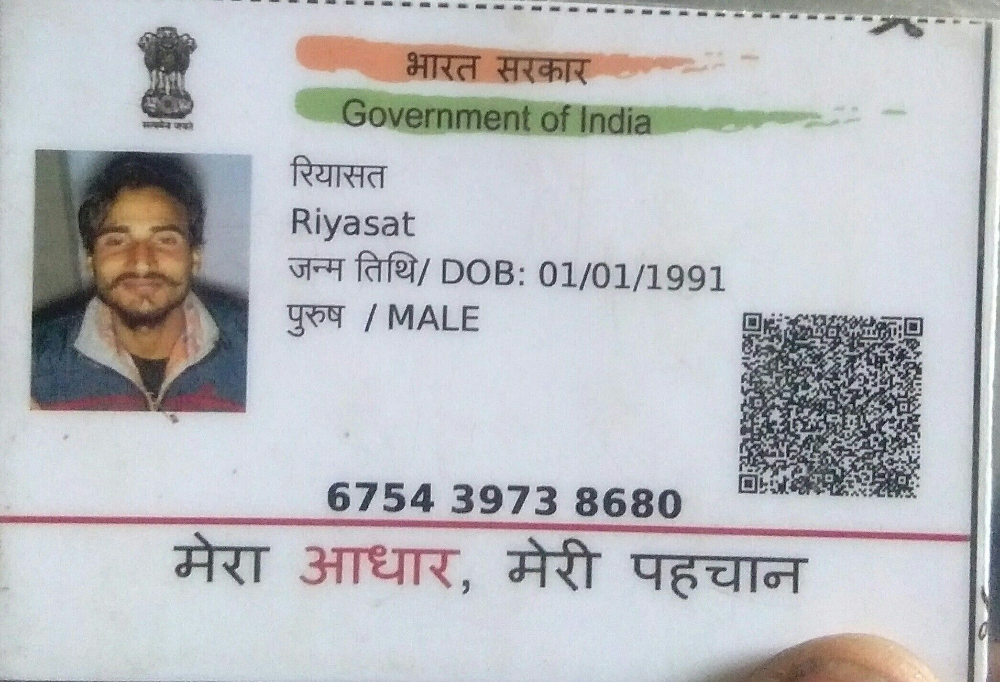

In [9]:
import PIL
from PIL import ImageDraw
img4 = PIL.Image.open('C://Users//hardi//Desktop//Scan and capture//new drive//adhar card//adhar 4.jpg')
img4

In [10]:
extract_text(img4)

Name: ['Riyasat']
Gender: ['MALE']
Date of Birth : ['01/01/1991']
adhar number : [['6754 3973 8680']]


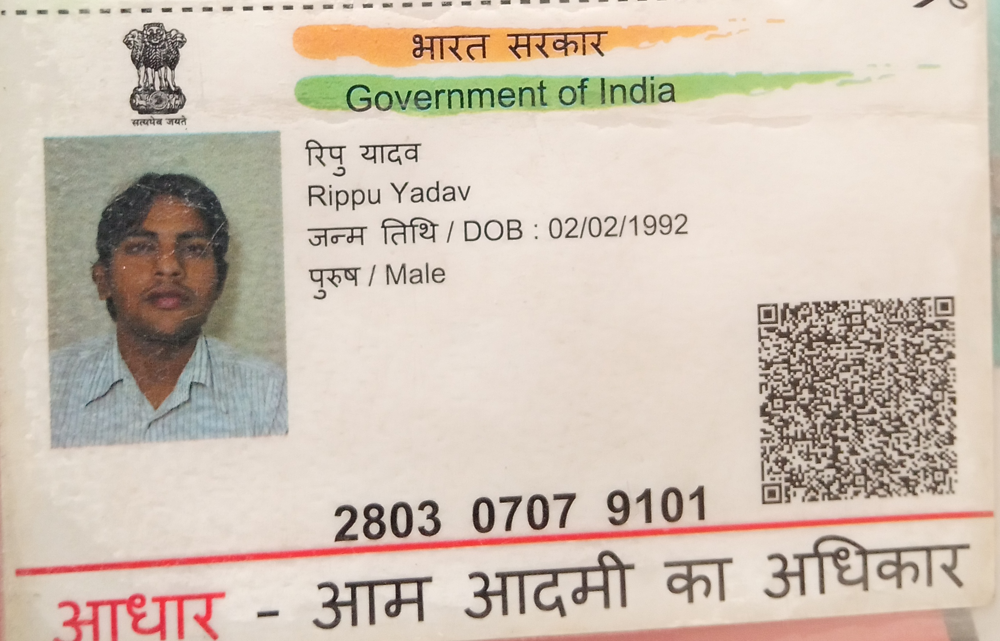

In [11]:
import PIL
from PIL import ImageDraw
img6 = PIL.Image.open('C://Users//hardi//Desktop//Scan and capture//new drive//adhar card//adhar 6.jpg')
img6

In [12]:
extract_text(img6)

Name: ['Rippu Yadav']
Gender: ['Male']
Date of Birth : ['02/02/1992']
adhar number : ['2803', '0707', '9101']


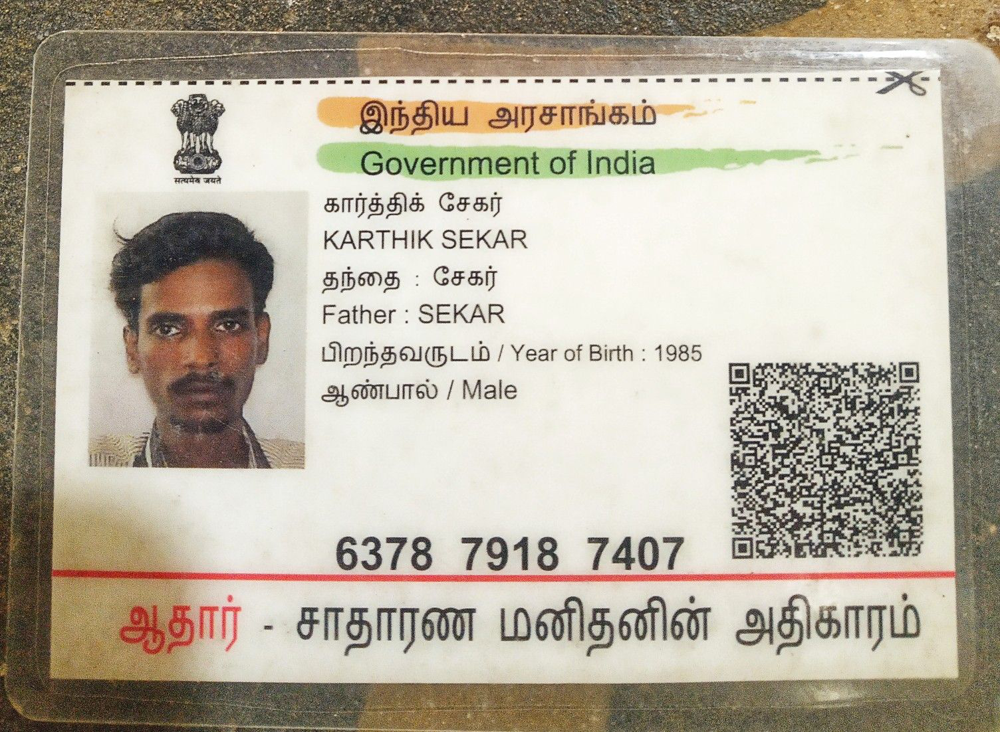

In [13]:
import PIL
from PIL import ImageDraw
img7 = PIL.Image.open('C://Users//hardi//Desktop//Scan and capture//new drive//adhar card//adhar 7.jpg')
img7

In [14]:
extract_text(img7)

Name: ['KARTHIK SEKAR']
Gender: ['Male']
Year of Birth: ['1985']
adhar number : ['6378', '7918', '7407']


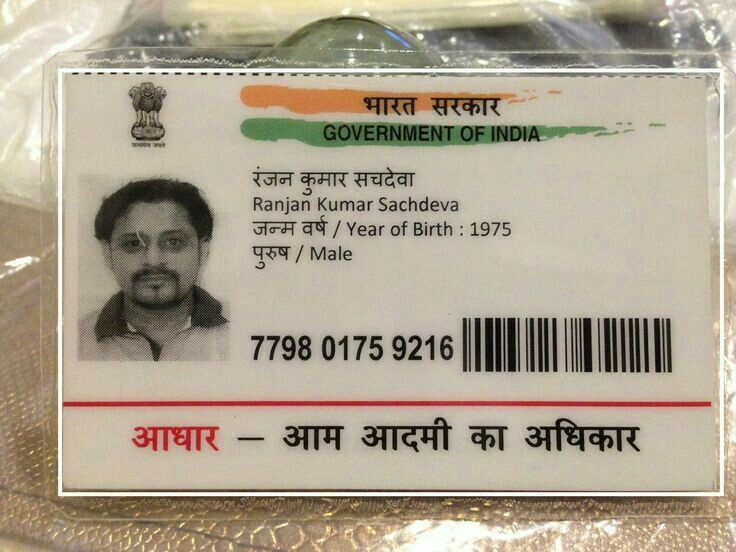

In [15]:
import PIL
from PIL import ImageDraw
img8 = PIL.Image.open('C://Users//hardi//Desktop//Scan and capture//new drive//adhar card//adhar 8.jpg')
img8

In [16]:
extract_text(img8)

Name: ['Ranjan Kumar Sachdeva']
Gender: ['Male']
Year of Birth: ['1975']
adhar number : [['7798 0175 9216']]


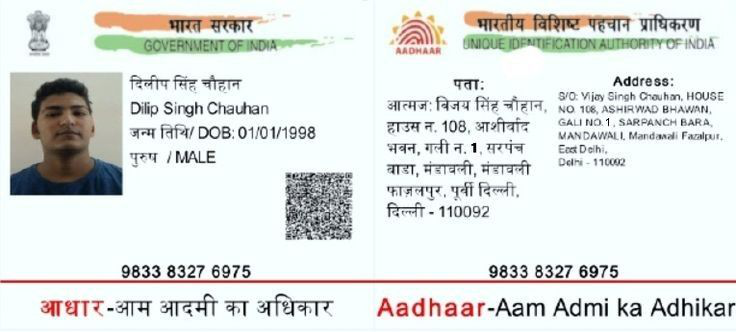

In [17]:
import PIL
from PIL import ImageDraw
img9 = PIL.Image.open('C://Users//hardi//Desktop//Scan and capture//new drive//adhar card//adhar 9.jpg')
img9

In [18]:
extract_text(img9)

Name: ['Dilip Sirgh Chauhan']
Gender: ['MALE']
Date of Birth : ['01/01/1998']
adhar number : [['9833 8327 6975'], ['9833 8327 6975']]


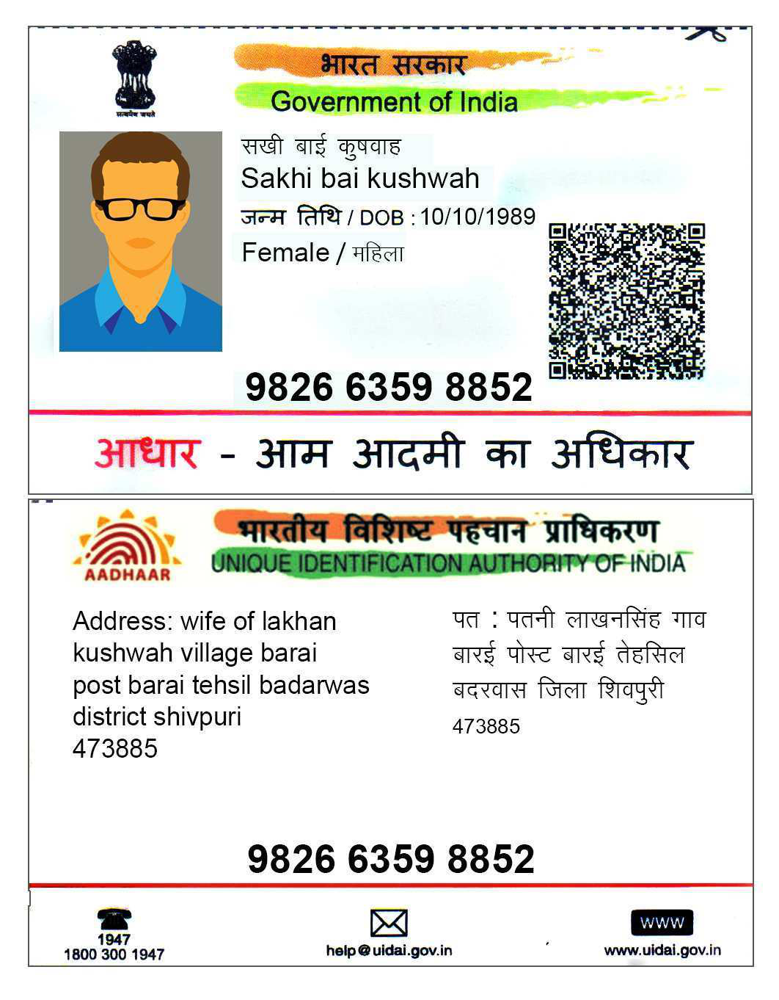

In [19]:
import PIL
from PIL import ImageDraw
img10 = PIL.Image.open('C://Users//hardi//Desktop//Scan and capture//new drive//adhar card//adhar 10.jpg')
img10

In [20]:
extract_text(img10)

Name: ['Sakhi bai kushwah', 'JA Ta@']
Name: ['Sakhi bai kushwah', 'JA Ta@', 'TT']
Gender: ['Female']
Date of Birth : ['10/10/1989']
adhar number : [['9826 6359 8852'], '1947']


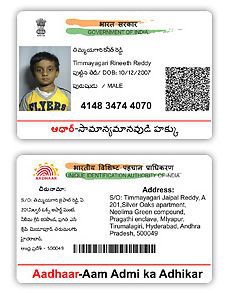

In [21]:
import PIL
from PIL import ImageDraw
img11 = PIL.Image.open('C://Users//hardi//Desktop//Scan and capture//new drive//adhar card//adhar 11.jpg')
img11

## For full vertical format adhar card:

In [29]:
def extract_text2(image):
    output=reader.readtext(image)
    output1 = reader.readtext(image, allowlist ='0123456789')
    
    for i in range(len(output)):
        result=output[i][-2]
        
    for i in range(len(output1)):
        result1=output1[i][-2]
        
        
    df1=pd.DataFrame(output)
    Extract_text=pd.DataFrame(df1[1])
    Extract_text.columns=['Text']
    
    df2=pd.DataFrame(output1)
    Extract_text1=pd.DataFrame(df2[1])
    Extract_text1.columns=['Number']
    # Name
    Name=[]
    for element in Extract_text['Text']:
        if re.findall('To',element):
            rowNAME=Extract_text[Extract_text['Text']=='To'].index
            rowNAME=rowNAME[0]
            rNAME=rowNAME+1
            NAME1=Extract_text.iloc[rNAME,0]
            Name.append(NAME1)
            break
    print('Name:', Name)
    
    # for gender
    Gender = []
    for element in Extract_text['Text']:
        if re.findall('(Female|Male|emale|male|ale|FEMALE|MALE|EMALE)$', element):
            Gender.append(re.findall('(Female|Male|emale|male|ale|FEMALE|MALE|EMALE)$', element))
            
      #Gender = Gender[0]
    print("Gender:", Gender[0])
    # for date of birth
    DOB = []
    YOB = []
    for element in Extract_text['Text']:
        if re.findall('Year of Birth: [0-9]{4}|of Birth [0-9]{4}|of Birth: [0-9]{4}', element):
            year=re.findall('Year of Birth: [0-9]{4}|of Birth [0-9]{4}|of Birth: [0-9]{4}', element)
            YOB.append(year)    
            print("Year of Birth:",YOB[0])
        elif re.findall('Year of Birth',element):
            rowYOB=Extract_text[Extract_text['Text']=='Year of Birth'].index
            rYOB=rowYOB[0]
            rYOB=rYOB+1
            YOB1=Extract_text.iloc[rYOB,0]
            YOB.append(YOB1)
            print('Year of Birth:',YOB)
        elif re.findall('of Birth',element):
            rowYOB=Extract_text[Extract_text['Text']=='of Birth'].index
            rYOB=rowYOB[0]
            rYOB=rYOB+1
            YOB1=Extract_text.iloc[rYOB,0]
            YOB.append(YOB1)
            print('Year of Birth:',YOB)
        elif re.findall('[0-9]{2}/[0-9]{2}/[0-9]{4}', element):
            DOB.append(re.findall('[0-9]{2}/[0-9]{2}/[0-9]{4}', element))
            print("Date of Birth :", DOB[0])
        elif re.findall('[0-9]{4}-[0-9]{2}-[0-9]{2}', element):
            DOB.append(re.findall('[0-9]{4}-[0-9]{2}-[0-9]{2}', element))
            print("Date of Birth :", DOB[0])
        elif re.findall('of Birth [0-9]{4}|of Birth: [0-9]{4}', element):
            year1=re.findall('of Birth [0-9]{4}|of Birth: [0-9]{4}', element)
            YOB.append(year1)   
        else:
            pass
    #for adhar number
    Adhar_number=[]
    for element in Extract_text['Text']:
        if re.findall('\d{4} \d{4} \d{4}'or'\d{12}', element):
            Adhar_number.append(re.findall('\d{4} \d{4} \d{4}'or'\d{12}', element))
            continue
    #elif (element.isdigit()):
            # if len(element)==4:
            #    Adhar_number.append(element)
    print("Adhar number:", Adhar_number[0])

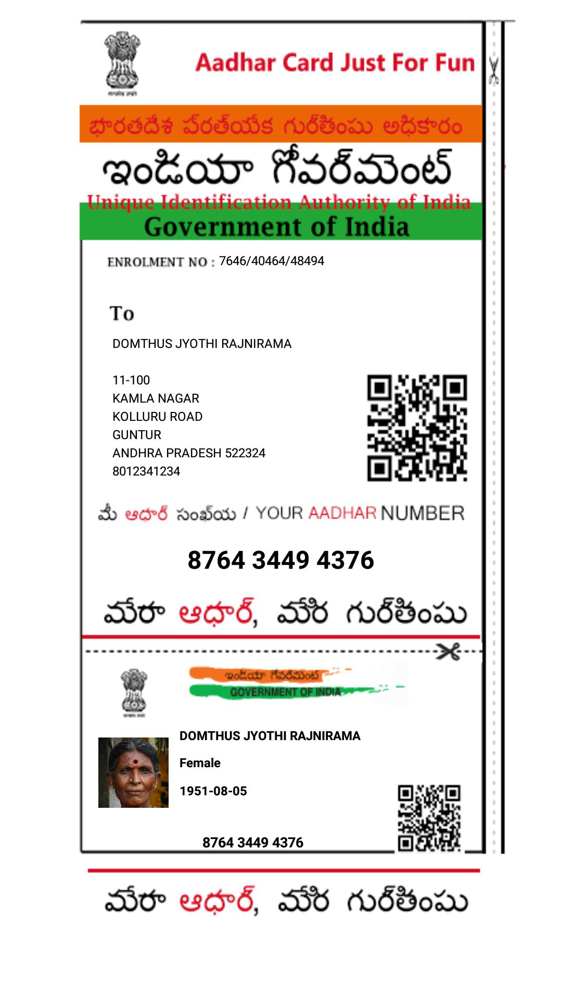

In [30]:
import PIL
from PIL import ImageDraw
img14 = PIL.Image.open('C://Users//hardi//Desktop//Scan and capture//new drive//adhar card//adhar 14.jpg')
img14

In [31]:
extract_text2(img14)

Name: ['DOMTHUS JYOTHI RAJNIRAMA']
Gender: ['Female']
Date of Birth : ['1951-08-05']
Adhar number: ['8764 3449 4376']


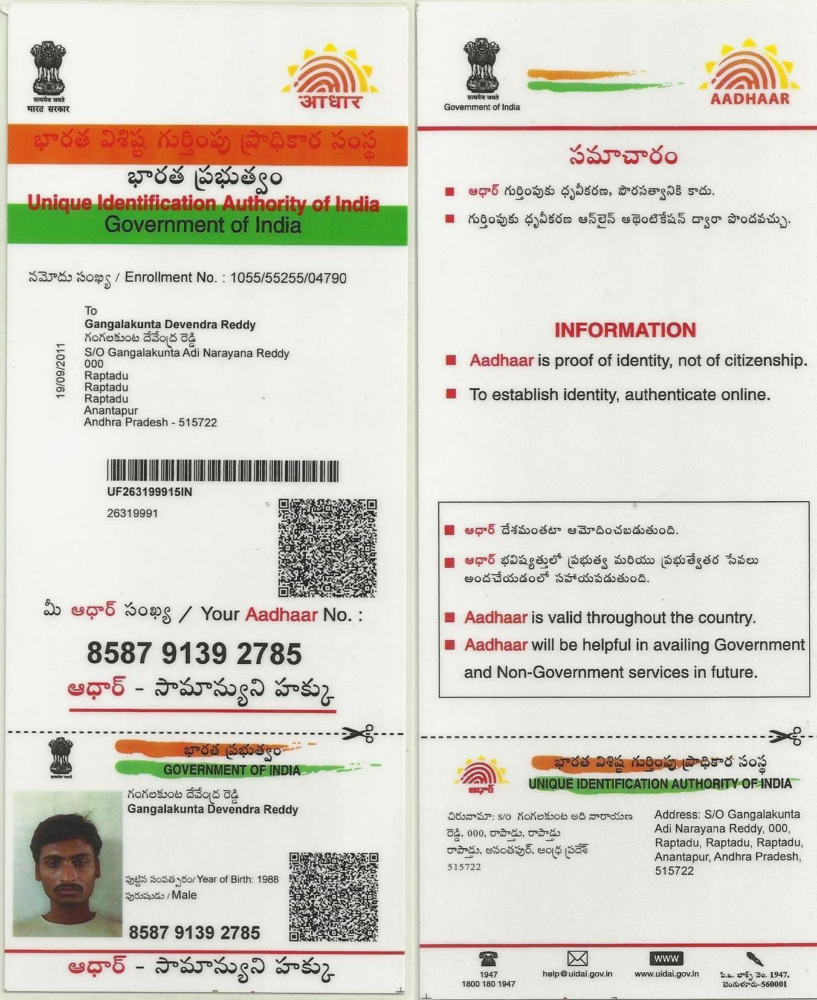

In [26]:
import PIL
from PIL import ImageDraw
img15 = PIL.Image.open('C://Users//hardi//Desktop//Scan and capture//new drive//adhar card//adhar 15.jpg')
img15

In [27]:
extract_text2(img15)

Name: ['Gangalakunta Devendra Reddy']
Gender: ['Male']
Year of Birth: ['Year of Birth: 1988']
Adhar number: ['8587 9139 2785']
